<a href="https://colab.research.google.com/github/a1s2d2f36g6g6q1/ComputerVision/blob/main/%5BLecture2%5D_ImageProcessing.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# 2025-1학기 Computer Vision - Lecture2 (보조학습자료)





1. 이미지 변환
2. 이미지 크기 축소
3. 이미지 특정 위치 지정하여 수정
4. 이미지 대칭
5.마스킹 Masking
6. 이미지의 각 채널 분할
7. Otsu 이진화 알고리즘
8. 감마보정하기 : 이미지의 밝기 조절
9. 히스토그램 평활화
10. Convolution
11. Edge Detection
12. Morphology

Colab에서 기본적으로 제공해주는 패키지나 프레임워크가 어떤것들이 있는지 확인하기 위하여 !pip list 명령어 입력

In [ ]:
!pip list

Package                            Version
---------------------------------- -------------------
absl-py                            1.4.0
accelerate                         1.5.2
aiohappyeyeballs                   2.6.1
aiohttp                            3.11.15
aiosignal                          1.3.2
alabaster                          1.0.0
albucore                           0.0.23
albumentations                     2.0.5
ale-py                             0.10.2
altair                             5.5.0
annotated-types                    0.7.0
anyio                              4.9.0
argon2-cffi                        23.1.0
argon2-cffi-bindings               21.2.0
array_record                       0.7.1
arviz                              0.21.0
astropy                            7.0.1
astropy-iers-data                  0.2025.3.31.0.36.18
astunparse                         1.6.3
atpublic                           5.1
attrs                              25.3.0
audioread            

OpenCV가 설치되어 있음을 확인하세요.  opencv-python   4.11.0.86

OpenCV가 제공해주는 기초적인 이미지 처리 기술을 알아봅시다.

# **1. 이미지 변환**
  
* 이미지 읽어오기
* 이미지 컬러 변경하기
* 이미지를 화면에 display하기

In [ ]:
import cv2    # OpenCV를 사용하기 위해 cv2 import

import numpy as np   # 넘파이 사용
import matplotlib.pyplot as plt   # matplotlib : 시각화라이브러리

from google.colab.patches import cv2_imshow    # colab에서 cv.imshow 사용

In [ ]:
# OpenCV 버전을 확인합니다.
print("OpenCV version:")
print(cv2.__version__)

OpenCV version:
4.11.0


Github에 있는 이미지 파일 다운로드
!wget https://raw.githubusercontent.com/username/repo/main/파일이름...


In [ ]:
# 깃헙 kjcheoi-class의 CV 리파지토리의 파일 lenna.jpg을 Colab 작업 디렉토리로 다운로드

!wget https://raw.githubusercontent.com/kjcheoi-class/CV/main/soccer.jpg


--2025-04-07 03:21:36--  https://raw.githubusercontent.com/kjcheoi-class/CV/main/soccer.jpg
Resolving raw.githubusercontent.com (raw.githubusercontent.com)... 185.199.108.133, 185.199.109.133, 185.199.110.133, ...
Connecting to raw.githubusercontent.com (raw.githubusercontent.com)|185.199.108.133|:443... connected.
HTTP request sent, awaiting response... 200 OK
Length: 449034 (439K) [image/jpeg]
Saving to: ‘soccer.jpg’

soccer.jpg          100%[===================>] 438.51K  --.-KB/s    in 0.05s   

2025-04-07 03:21:36 (9.22 MB/s) - ‘soccer.jpg’ saved [449034/449034]



In [ ]:
# 이미지 불러오기 edge.jpg
img = cv2.imread('soccer.jpg')
if img is not None:
    print("이미지를 읽어왔습니다.")
else:
    print("이미지를 읽어오지 못했습니다.")
print(f"변수 타입: {type(img)}")

이미지를 읽어왔습니다.
변수 타입: <class 'numpy.ndarray'>


In [ ]:
# 이미지 정보 출력 : 가로, 세로, 채널
print(img.shape)

print("\nwidth: {} pixels".format(img.shape[1]))
print("height: {} pixels".format(img.shape[0]))
print("channels: {}".format(img.shape[2]))



(948, 1434, 3)

width: 1434 pixels
height: 948 pixels
channels: 3


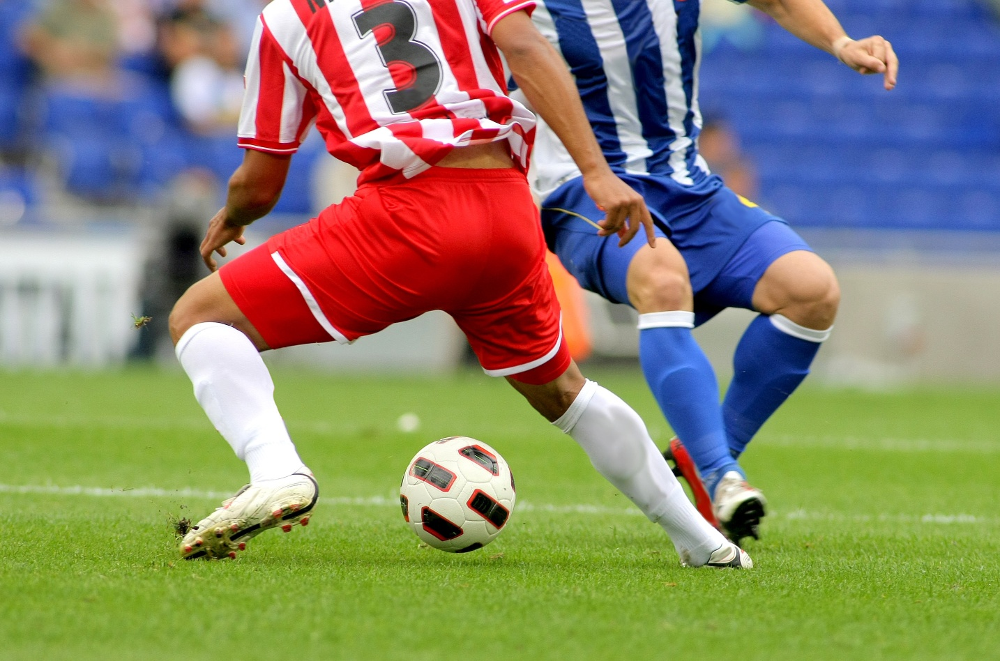

In [ ]:
# 이미지 출력
cv2_imshow(img)

# **2. 이미지 크기 축소**

In [ ]:
# BGR 컬러 영상을 명암 영상으로 변환
gray = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)

# 반으로 축소
gray_small=cv2.resize(gray,dsize=(0,0),fx=0.5,fy=0.5)

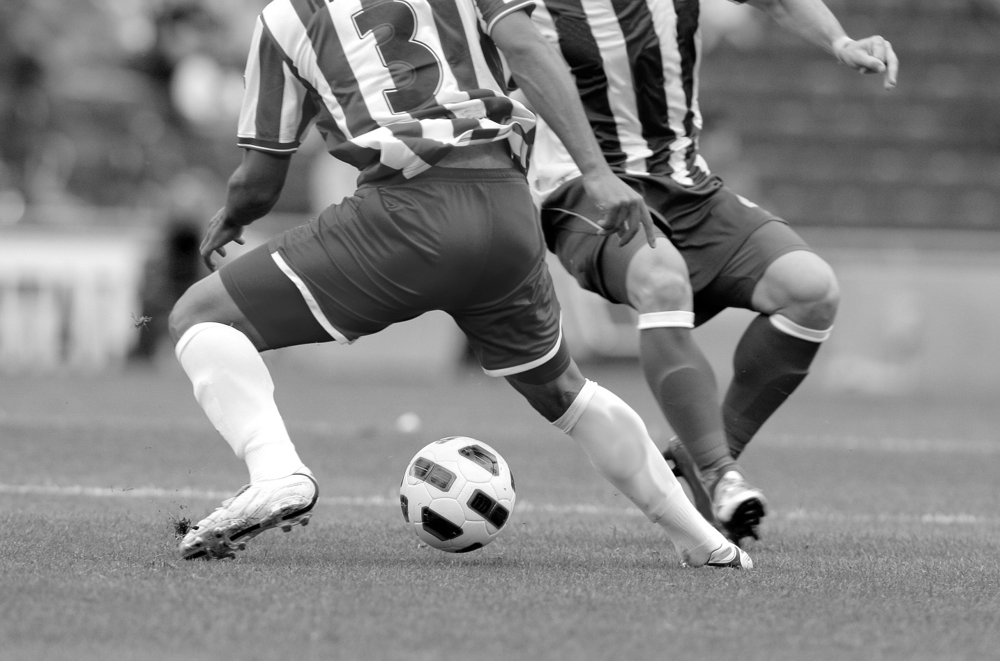

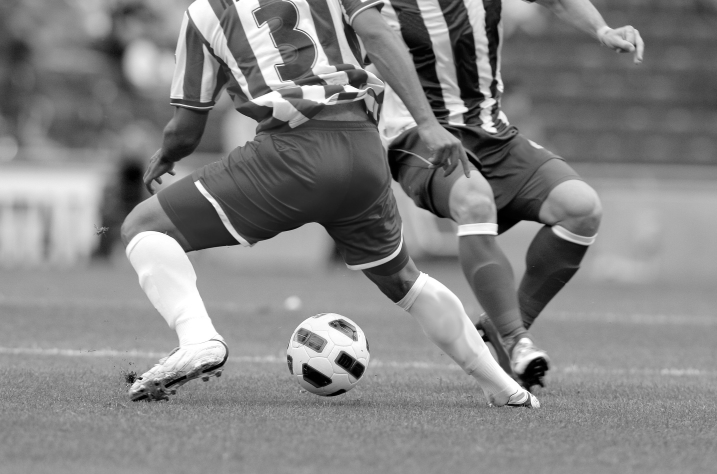

In [ ]:
# 이미지 출력
cv2_imshow(gray)
cv2_imshow(gray_small)

In [ ]:
# 영상을 파일에 저장
cv2.imwrite("soccer_gray.jpg",gray)
cv2.imwrite('soccer_gray_small.jpg',gray_small)

True

In [ ]:
print(gray.shape)

(948, 1434)


In [ ]:
print(gray_small.shape)

(474, 717)


# **3. 이미지 특정 위치 지정하여 수정**



In [ ]:
# 이미지의 특정 위치 = 픽셀(Pixel), Pixel(BGB)
(b, g, r) = img[0, 0]
print("Pixel at (0, 0) - Red: {}, Green: {}, Blue: {}".format(r, g, b))

Pixel at (0, 0) - Red: 98, Green: 104, Blue: 162


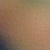

In [ ]:
# 이미지에서 특정한 범위만 지정하여 Display
ROI = img[50:100, 50:100]
cv2_imshow(ROI)

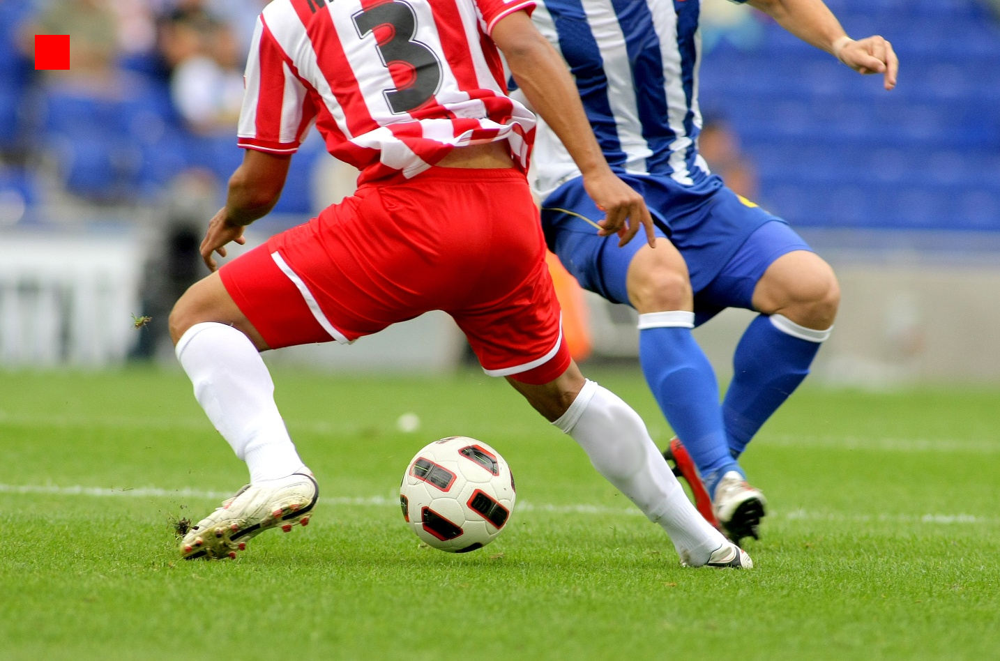

In [ ]:
# 이미지 내에서 특정한 범위만 지정하여 색상 변경
img[50:100, 50:100] = (0, 0, 255)

cv2_imshow(img)

# **4. 이미지 대칭**

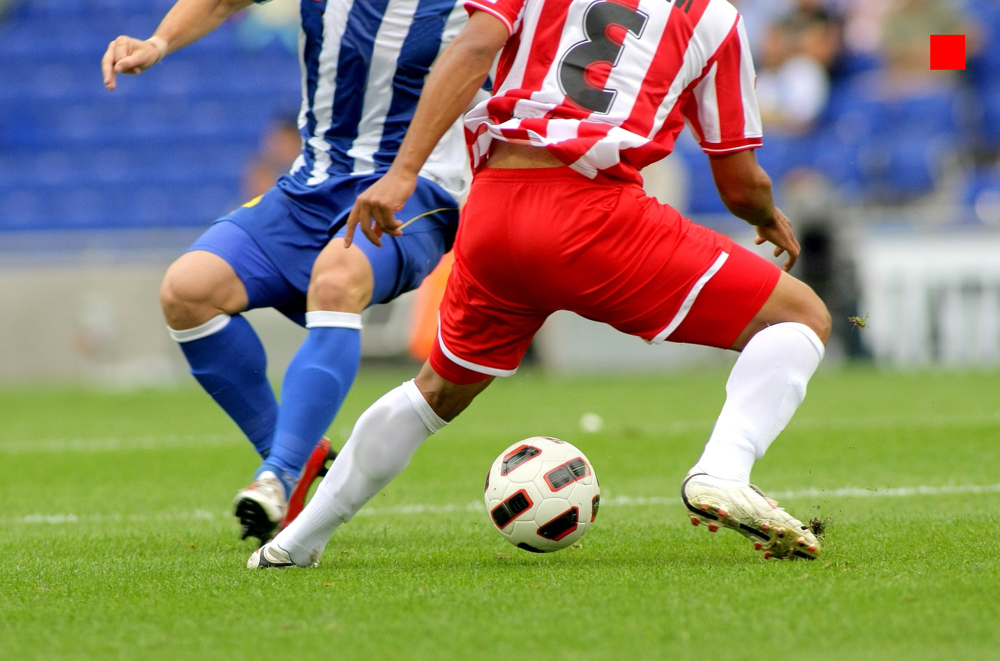

In [ ]:
# 이미지를 대칭시킴(좌/우 대칭, 상/하 대칭), "Flipped Horizontal 1, Vertical 0, both -1 "
flipped = cv2.flip(img, 1)
cv2_imshow(flipped)

# **5.마스킹 Masking**

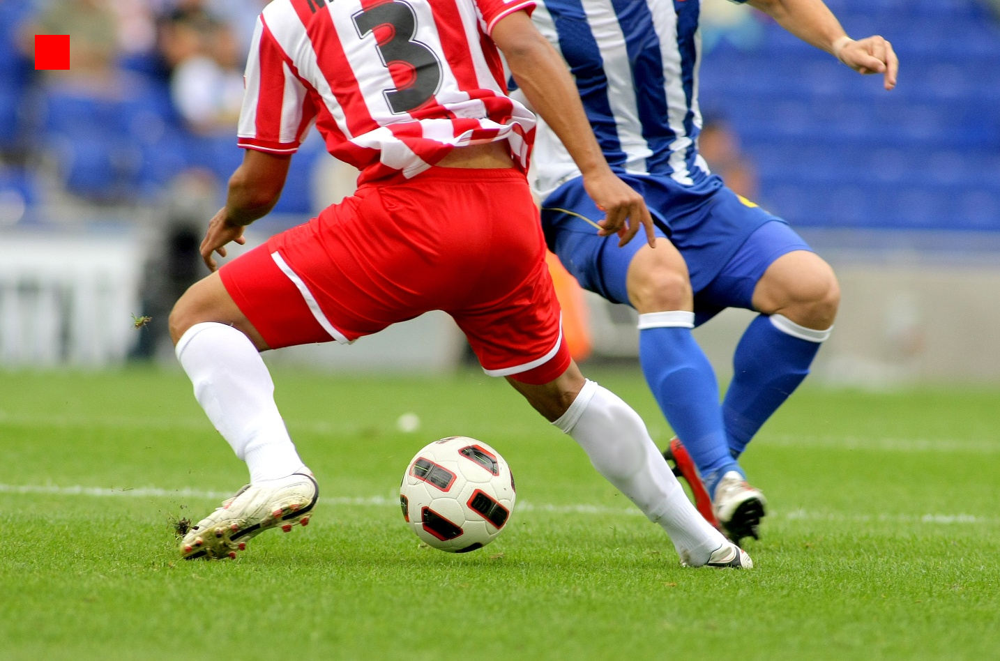

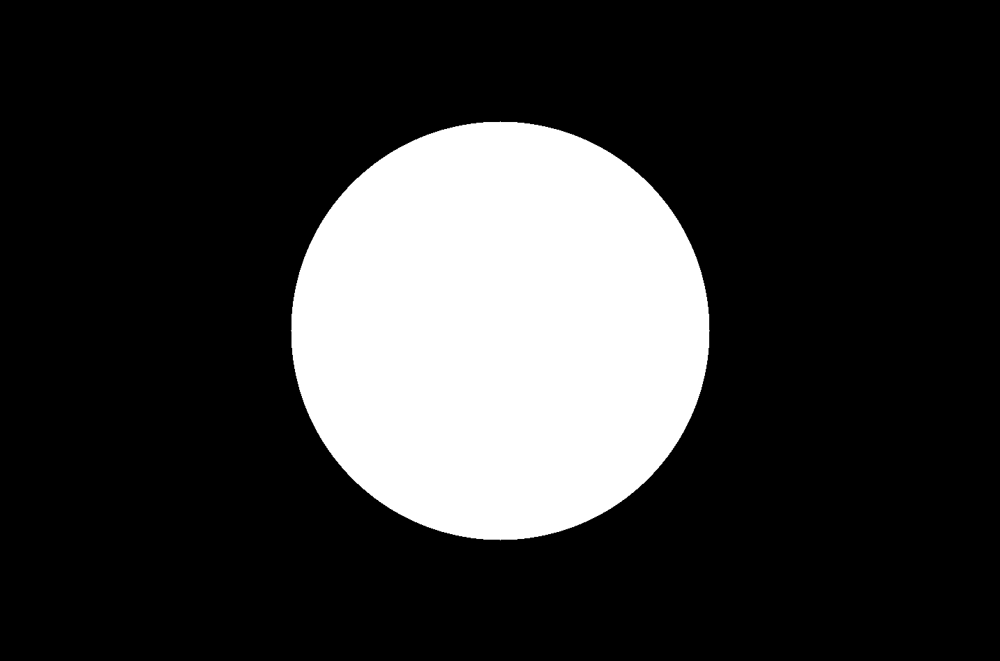

In [ ]:
# 이미지의 높이와 넓이를 가져옴.
(height, width) = img.shape[:2]
# 이미지의 중심 구하기
center = (width // 2, height // 2)

cv2_imshow(img)

# 이미지 크기와 동일한 mask 생성
mask = np.zeros(img.shape[:2], dtype = "uint8")

# mask 에 filter 시킬 모양(흰색 원)을 그리기
cv2.circle(mask, center, 300, (255, 255, 255), -1)

# mask를 Display
cv2_imshow(mask)

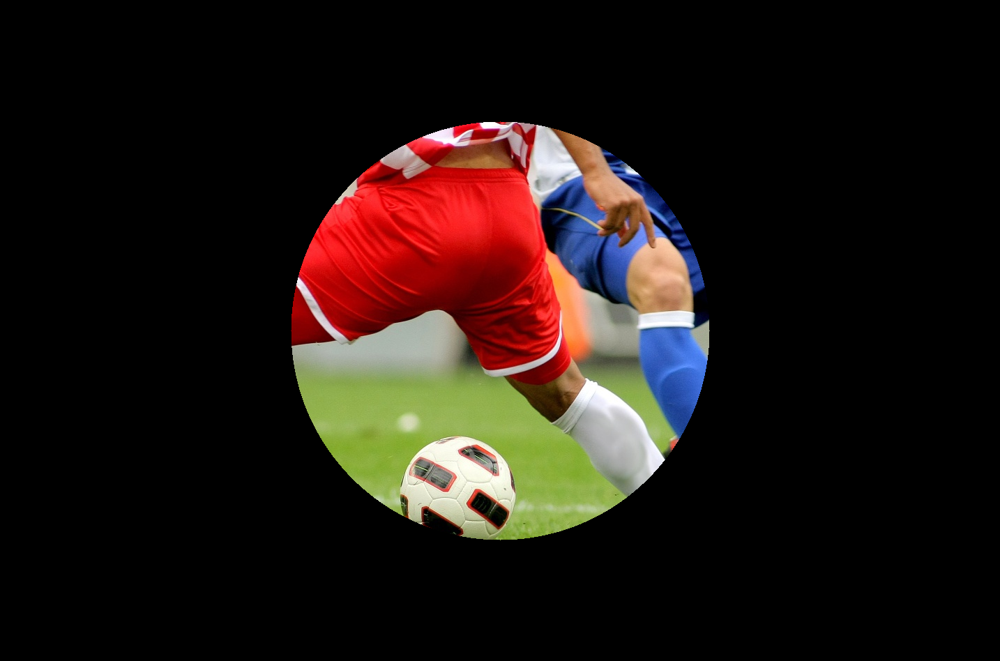

In [ ]:
# 이미지에 mask 적용. bitwise_and 연산
masked = cv2.bitwise_and(img, img, mask = mask)

# 마스크된 이미지 Display
cv2_imshow(masked)

# **6. 이미지의 각 채널 분할**

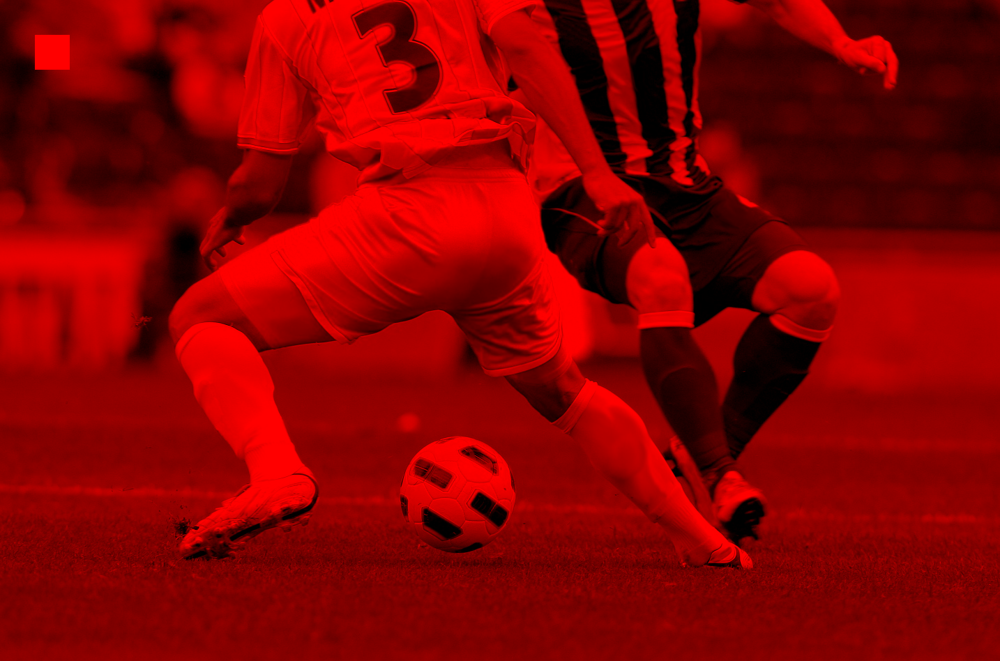

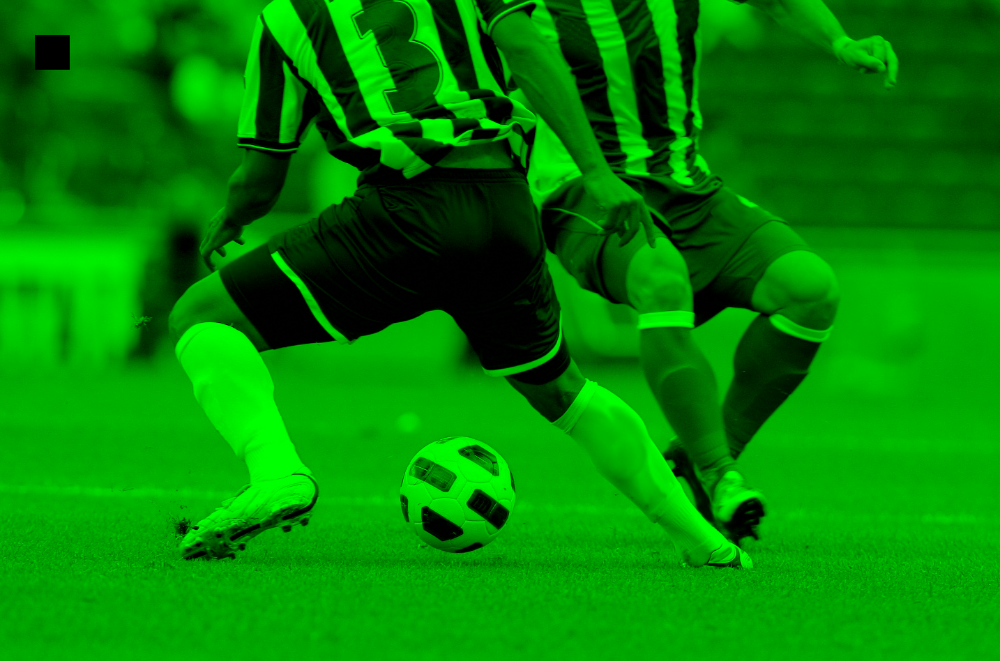

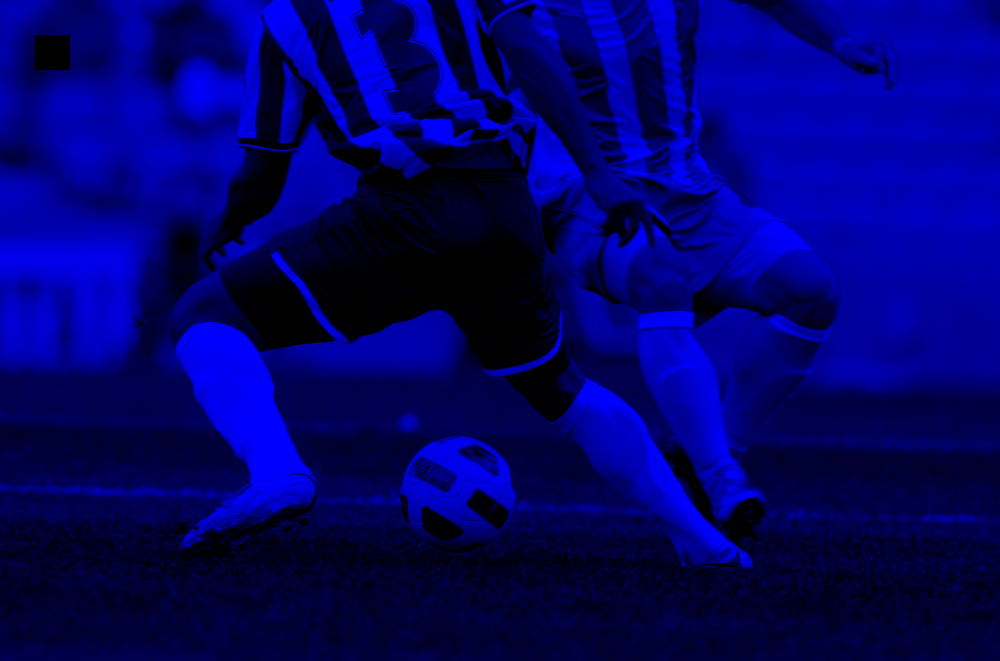

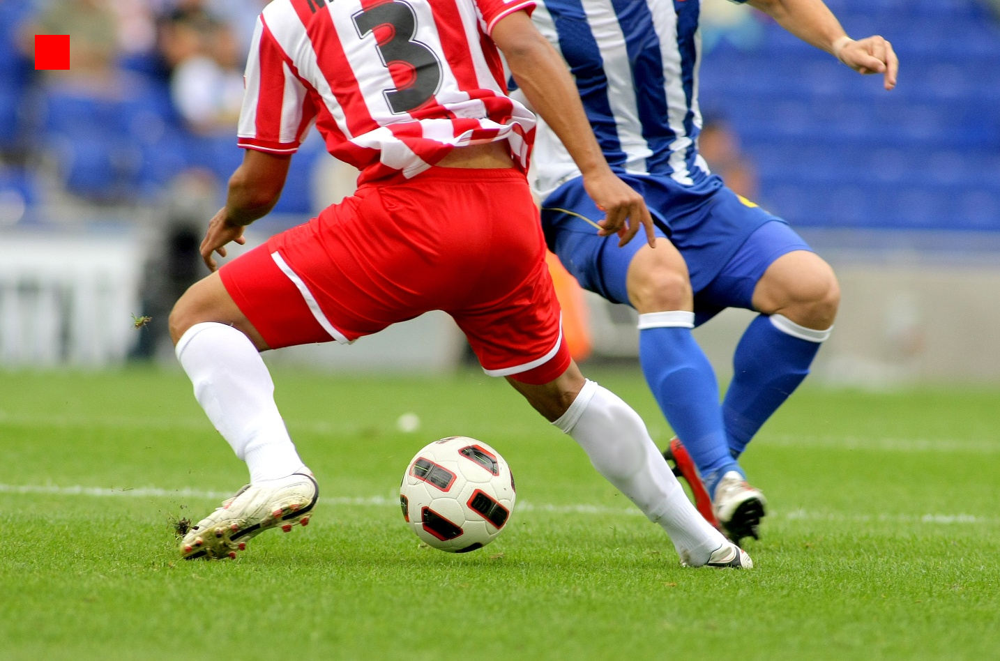

In [ ]:
# 이미지 채널 분할.
(Blue, Green, Red) = cv2.split(img)

# 이미지 채널의 합성 결과 Display
zeros = np.zeros(img.shape[:2], dtype = "uint8")
cv2_imshow(cv2.merge([zeros, zeros, Red]))
cv2_imshow(cv2.merge([zeros, Green, zeros]))
cv2_imshow(cv2.merge([Blue, zeros, zeros]))

# 분할된 3채널의 이미지들을 모두 합하여 Display
BGR = cv2.merge([Blue, Green, Red])
cv2_imshow(BGR)

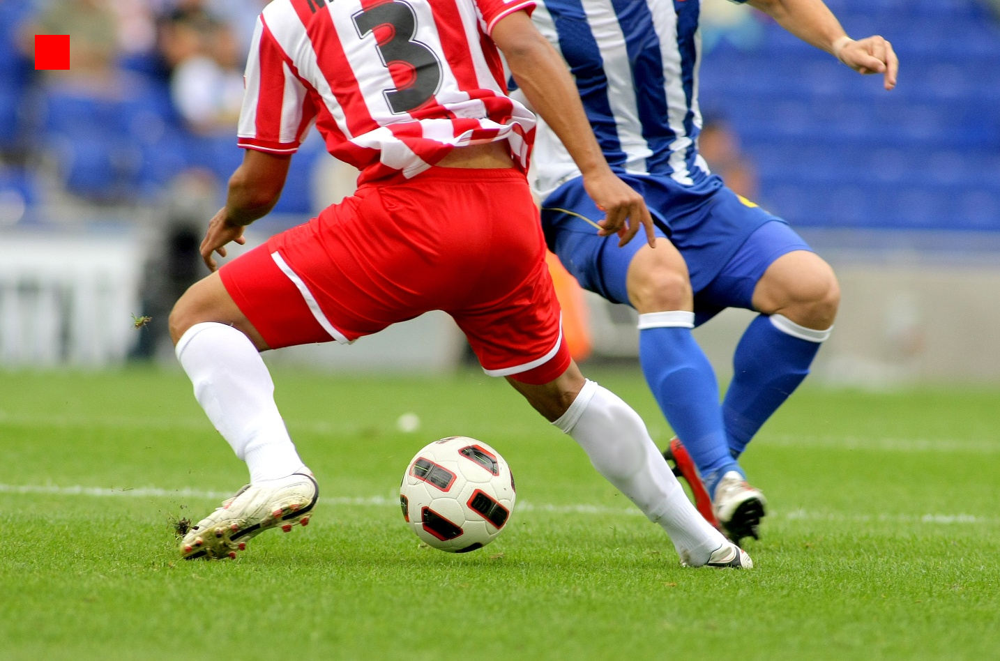

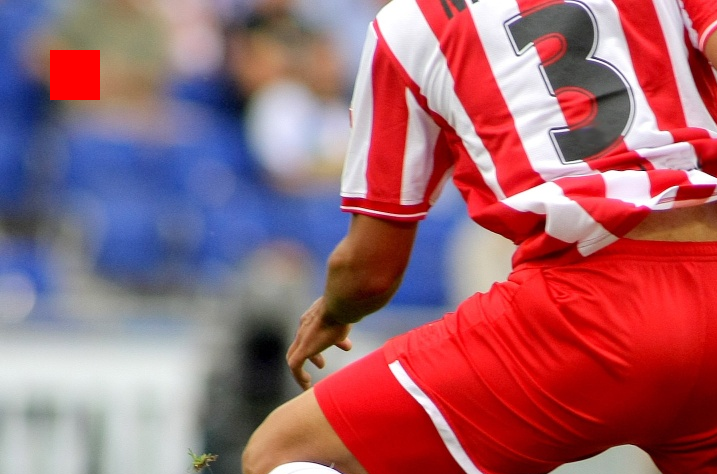

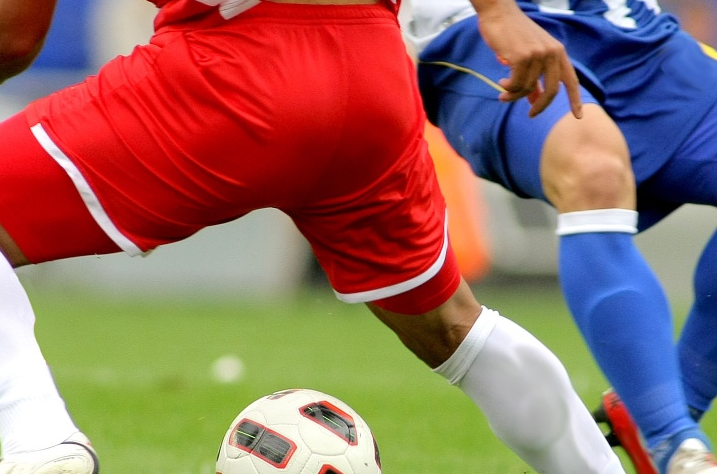

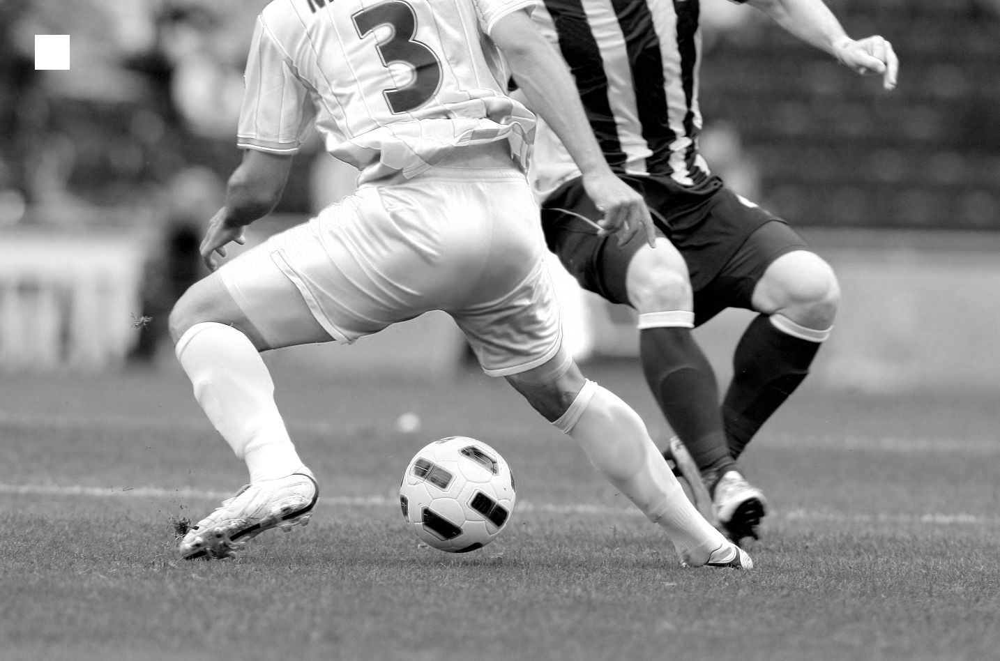

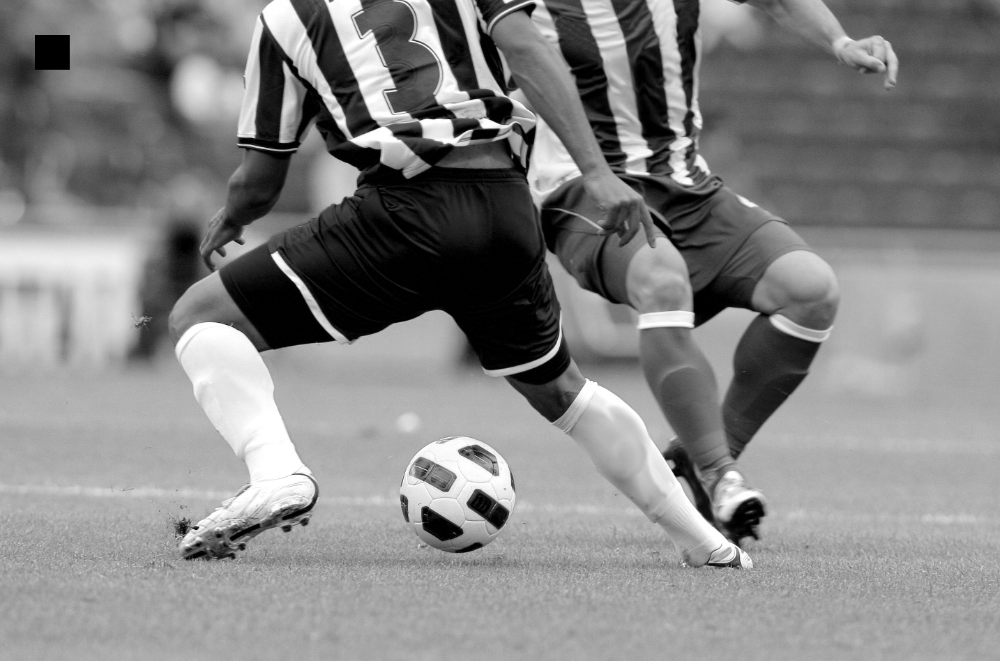

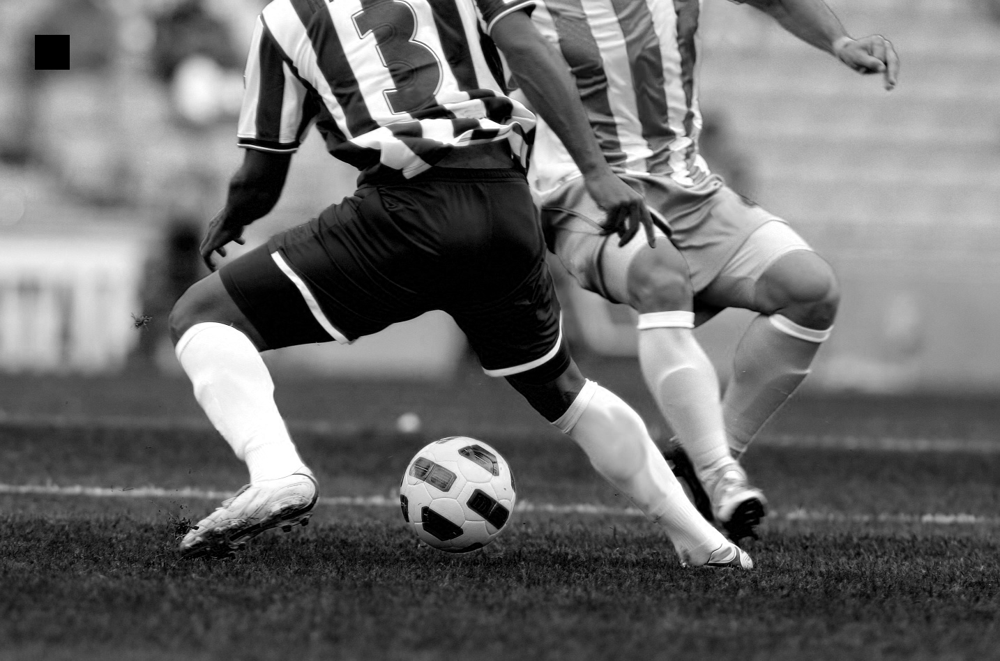

In [ ]:
cv2_imshow(img)  ## original_RGB
cv2_imshow(img[0:img.shape[0]//2,0:img.shape[1]//2,:])  #Upper left half
cv2_imshow(img[img.shape[0]//4:3*img.shape[0]//4,img.shape[1]//4:3*img.shape[1]//4,:]) # Center half

cv2_imshow(img[:,:,2]) # R channel
cv2_imshow(img[:,:,1]) # G channel
cv2_imshow(img[:,:,0]) # B channel


# **7. Otsu 이진화 알고리즘**


오츄 알고리즘이 찾은 최적 임곗값= 113.0


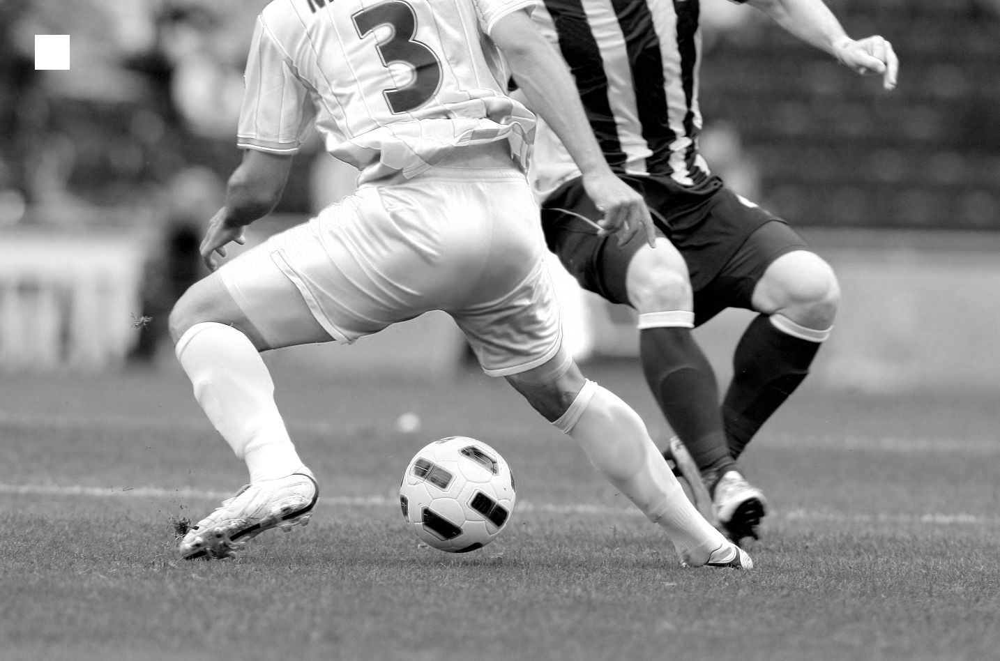

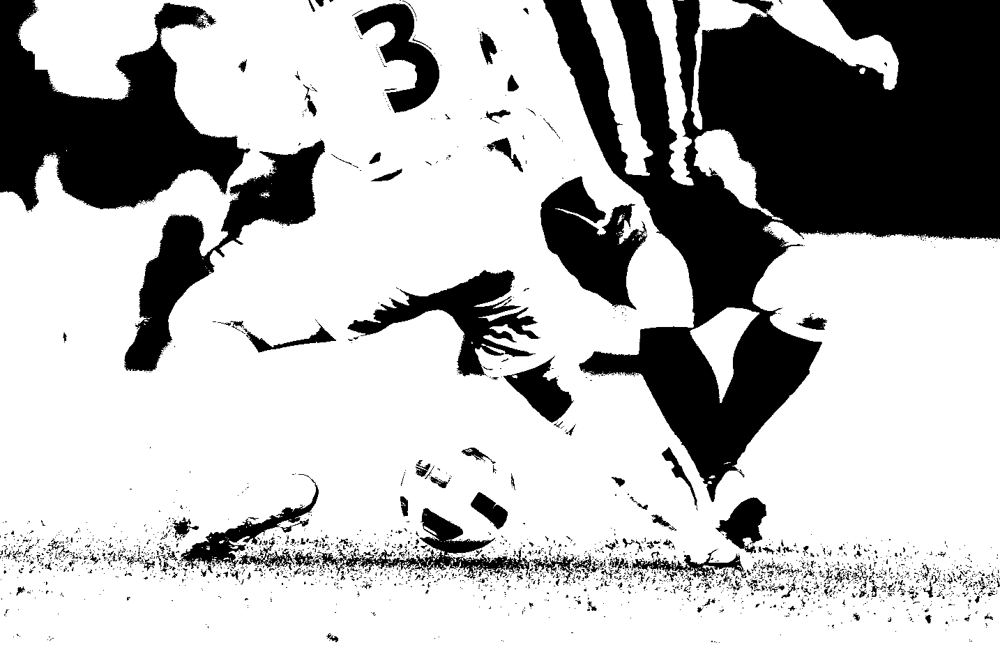

In [ ]:
t,bin_img=cv2.threshold(img[:,:,2],0,255,cv2.THRESH_BINARY+cv2.THRESH_OTSU)
print('오츄 알고리즘이 찾은 최적 임곗값=',t)

cv2_imshow(img[:,:,2])			# R 채널 영상
cv2_imshow(bin_img)	# R 채널 이진화 영상

# 8. **감마보정하기**  : 이미지의 밝기 조절    


*   gamma < 1이면 어두운 부분이 밝아짐
*   gamma > 1이면 밝은 부분이 어두워짐






In [ ]:
#깃헙의 파일을 Colab 작업 디렉토리로 다운로드

!wget https://raw.githubusercontent.com/kjcheoi-class/CV/main/lena.jpg


--2025-04-07 03:22:26--  https://raw.githubusercontent.com/kjcheoi-class/CV/main/lena.jpg
Resolving raw.githubusercontent.com (raw.githubusercontent.com)... 185.199.111.133, 185.199.108.133, 185.199.110.133, ...
Connecting to raw.githubusercontent.com (raw.githubusercontent.com)|185.199.111.133|:443... connected.
HTTP request sent, awaiting response... 200 OK
Length: 91814 (90K) [image/jpeg]
Saving to: ‘lena.jpg’

lena.jpg            100%[===================>]  89.66K  --.-KB/s    in 0.02s   

2025-04-07 03:22:27 (3.63 MB/s) - ‘lena.jpg’ saved [91814/91814]



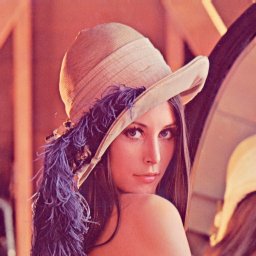

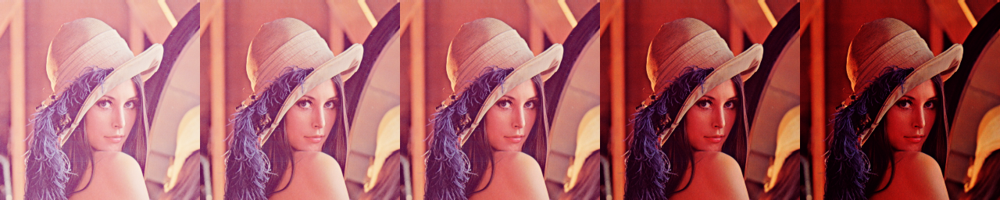

In [ ]:
img=cv2.imread('lena.jpg')

img=cv2.resize(img,dsize=(0,0),fx=0.5,fy=0.5)
cv2_imshow(img)

def gamma(f,gamma=1.0):
    f1=f/255.0			# L=256이라고 가정, 픽셀을 0~1로 정규
    return np.uint8(255*(f1**gamma))   # 감마 보정 후 다시 0~255로 변환

gc=np.hstack((gamma(img,0.5),gamma(img,0.75),gamma(img,1.0),gamma(img,2.0),gamma(img,3.0)))
## np.hstack : NumPy 배열을 '수평(Horizontal)'으로 쌓아주는 함수
cv2_imshow(gc)

In [ ]:
#깃헙의 파일을 Colab 작업 디렉토리로 다운로드

!wget https://raw.githubusercontent.com/kjcheoi-class/CV/main/mistyroad.jpg

--2025-04-07 03:22:31--  https://raw.githubusercontent.com/kjcheoi-class/CV/main/mistyroad.jpg
Resolving raw.githubusercontent.com (raw.githubusercontent.com)... 185.199.108.133, 185.199.110.133, 185.199.109.133, ...
Connecting to raw.githubusercontent.com (raw.githubusercontent.com)|185.199.108.133|:443... connected.
HTTP request sent, awaiting response... 200 OK
Length: 382133 (373K) [image/jpeg]
Saving to: ‘mistyroad.jpg’

mistyroad.jpg       100%[===================>] 373.18K  --.-KB/s    in 0.05s   

2025-04-07 03:22:31 (7.84 MB/s) - ‘mistyroad.jpg’ saved [382133/382133]



# **9. 히스토그램 평활화**

1) 히스토그램 계산 함수 : 각 밝기 레벨(0~255)마다 픽셀의 개수가 담긴 256 길이의 배열 h가 반환됨.

   **h= cv2.calcHist([img], [0], None, [256], [0,256])**

   * [img] : 대상 이미지 (리스트 형태로 전달)
   * [0] : 채널 번호 (0은 그레이스케일이기 때문에 채널 하나)
   * None : 마스크 사용 안 함 (전체 이미지 대상으로)
   * [0,256] : 픽셀 값의 범위
   * [256] : 히스토그램 구간 개수 (0~255 → 256개 구간)

    
2) 히스토그램 평활화 함수
  **cv2.equalizeHist(gray)**





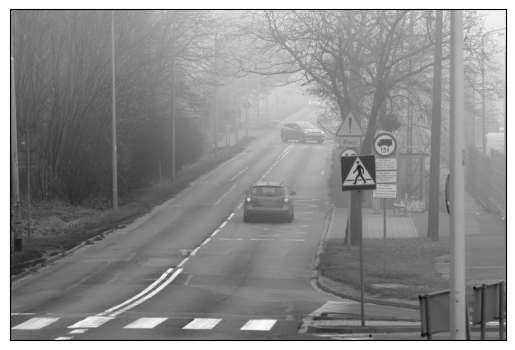

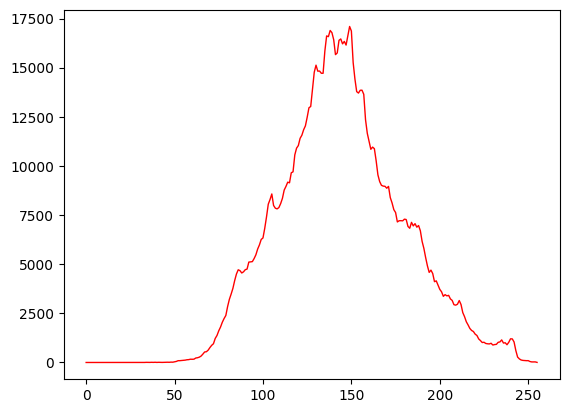

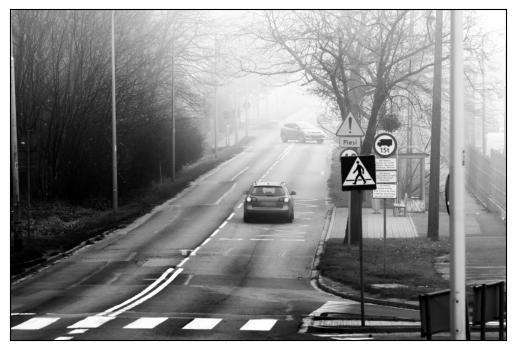

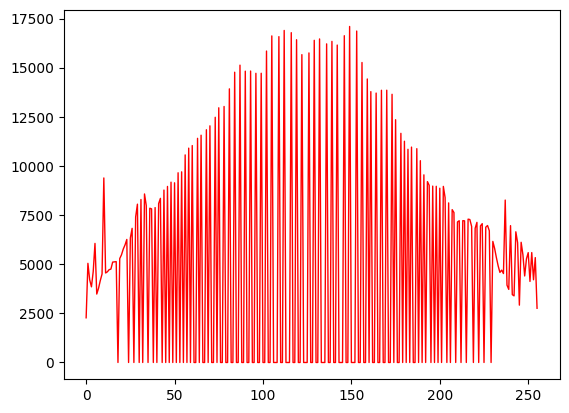

In [ ]:
img=cv2.imread('mistyroad.jpg')

gray=cv2.cvtColor(img,cv2.COLOR_BGR2GRAY)		# 명암 영상으로 변환하고 출력
plt.imshow(gray,cmap='gray'), plt.xticks([]), plt.yticks([]), plt.show()

h=cv2.calcHist([gray],[0],None,[256],[0,256])	# 히스토그램을 구해 출력
plt.plot(h,color='r',linewidth=1), plt.show() # 계산한 히스토그램을 빨간 색 선으로 시각화

equal=cv2.equalizeHist(gray) # 히스토그램을 평활화하고 출력
plt.imshow(equal,cmap='gray'), plt.xticks([]), plt.yticks([]), plt.show()

h=cv2.calcHist([equal],[0],None,[256],[0,256])	# 히스토그램을 구해 출력
plt.plot(h,color='r',linewidth=1)
plt.show()

# **10. Convolution**

*   GaussianBlur()
*   Filter2D

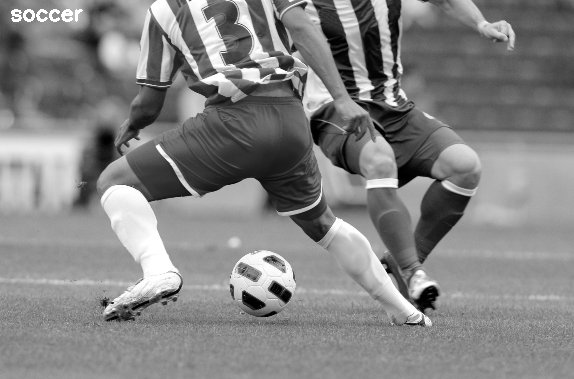



Gaussian Blur 5x5 / 9x9 / 15x15 결과



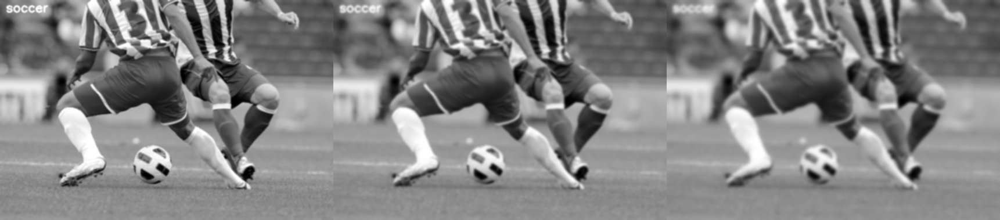

In [ ]:
## 가우시안 필터

img=cv2.imread('soccer.jpg')
img=cv2.resize(img,dsize=(0,0),fx=0.4,fy=0.4)
gray=cv2.cvtColor(img,cv2.COLOR_BGR2GRAY)
cv2.putText(gray,'soccer',(10,20),cv2.FONT_HERSHEY_SIMPLEX,0.7,(255,255,255),2)
cv2_imshow(gray)

print("\n\nGaussian Blur 5x5 / 9x9 / 15x15 결과\n")
smooth=np.hstack((cv2.GaussianBlur(gray,(5,5),0.0),cv2.GaussianBlur(gray,(9,9),0.0),cv2.GaussianBlur(gray,(15,15),0.0)))
cv2_imshow(smooth)

잘 된 결과



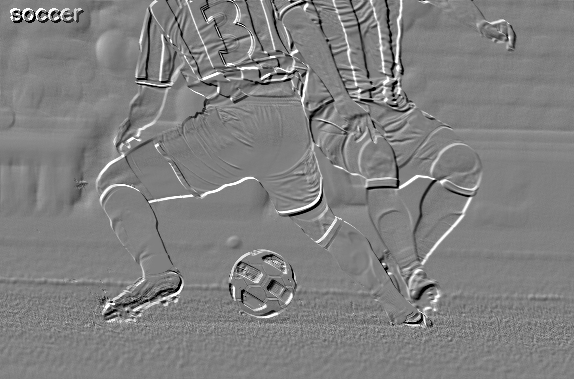



잘못된 처리 결과



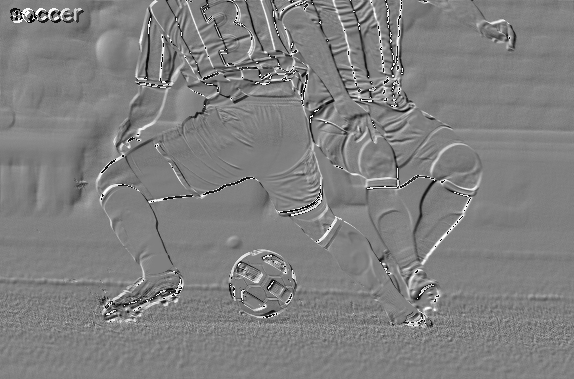



더 잘못된 처리 결과



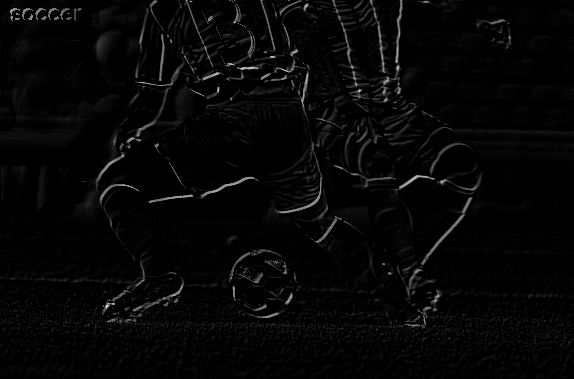

In [ ]:
## 엠보싱 필터
##     엠보싱 : 이미지에 깊이값을 주기 위해 픽셀의 차이를 강조하는 연산
##     왼쪽 위 픽셀값을 음수(-1), 오른쪽 아래 픽셀값을 (+1)로 두고 주변과의 차이를 강조

femboss=np.array([[-1.0, 0.0, 0.0],
                  [ 0.0, 0.0, 0.0],
                  [ 0.0, 0.0, 1.0]])

gray16=np.int16(gray)  ## 필터 연산 중 음수가 나올 수 있으므로 16비트 정수로 변환 (안전하게 부호있는 정수int16으로 변환하여) 음수도 담을 수 있도록 함.

## cv2.filter2D() + 128 : 2D 컨볼루션 연산. 보싱 필터의 결과는 0 기준으로 음수/양수가 나오기 때문에 전체적으로 128을 더해 중앙값을 이동
## clip : 값이 0보다 작으면 0, 255보다 크면 255로 잘라줌
## 정상적인 엠보싱 처리. int16로 변환, +128 중심 이동, 클리핑 적용 후 uint8 변환.
emboss=np.uint8(np.clip(cv2.filter2D(gray16,-1,femboss)+128,0,255))

## 잘못된 처리 예시
## 클리핑 없이 uint8로 바로 변환해서 wrap-around 현상으로 잘못된 결과.
emboss_bad=np.uint8(cv2.filter2D(gray16,-1,femboss)+128)

## 더 잘못된 처리 예시
## uint8에서 필터 연산을 직접 진행해 음수/overflow 처리 안 된 채 잘못된 결과.
emboss_worse=cv2.filter2D(gray,-1,femboss)

print("잘 된 결과\n")
cv2_imshow(emboss)
print("\n\n잘못된 처리 결과\n")
cv2_imshow(emboss_bad)
print("\n\n더 잘못된 처리 결과\n")
cv2_imshow(emboss_worse)

# **11. Edge Detection**
*  Sobel
*  Canny


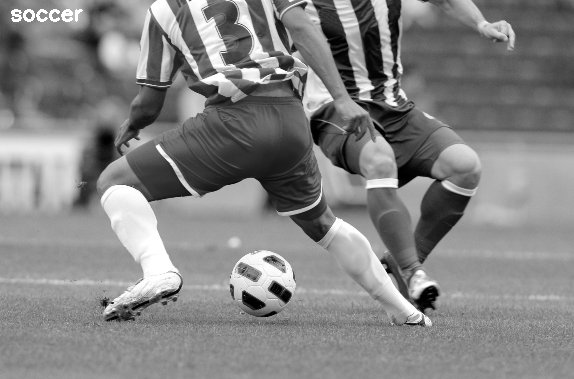


sobelx



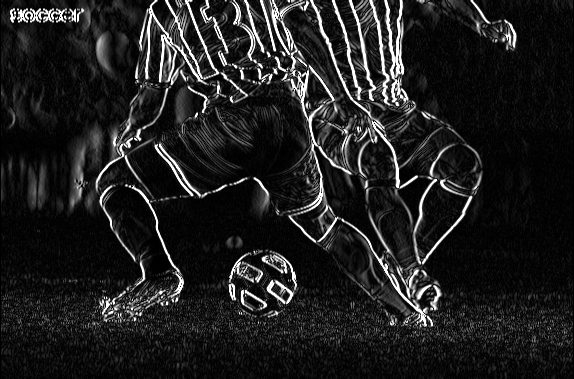


sobely



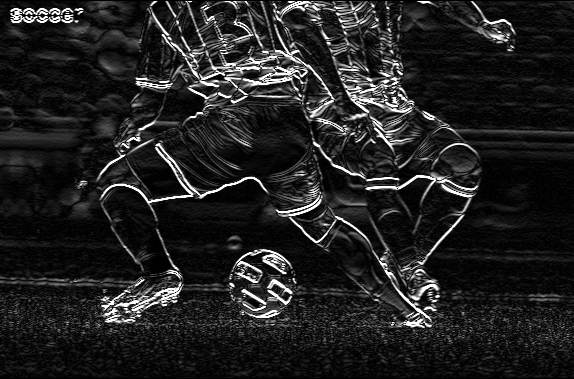


edge_strength



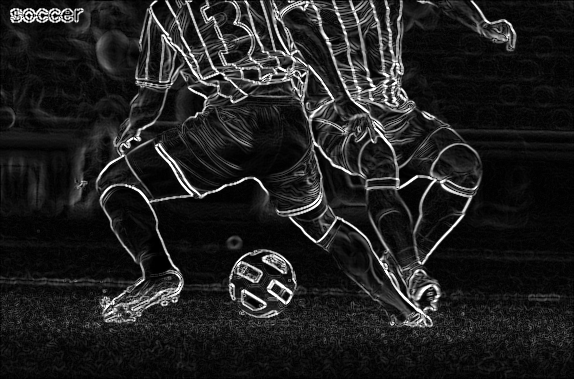

In [ ]:
# 3x3 소벨 연산자 적용

grad_x=cv2.Sobel(gray,cv2.CV_32F,1,0,ksize=3)
grad_y=cv2.Sobel(gray,cv2.CV_32F,0,1,ksize=3)

sobel_x=cv2.convertScaleAbs(grad_x)	# 절대값을 취해 양수 영상으로 변환
sobel_y=cv2.convertScaleAbs(grad_y)

edge_strength=cv2.addWeighted(sobel_x,0.5,sobel_y,0.5,0)	# 에지 강도 계산

cv2_imshow(gray)   ## Original
print("\nsobelx\n")
cv2_imshow(sobel_x) ## sobelx
print("\nsobely\n")
cv2_imshow(sobel_y) ## sobely
print("\nedge_strength\n")
cv2_imshow(edge_strength) ## edge_strength

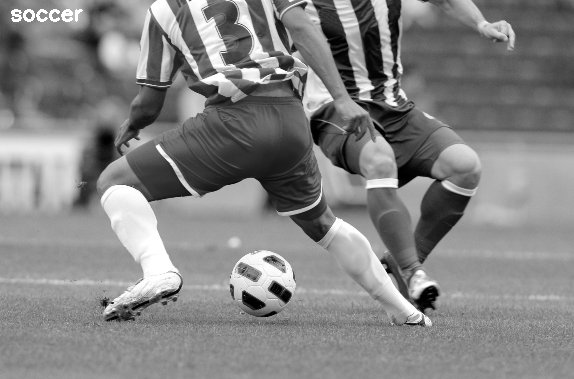


Tlow=50, Thigh=150



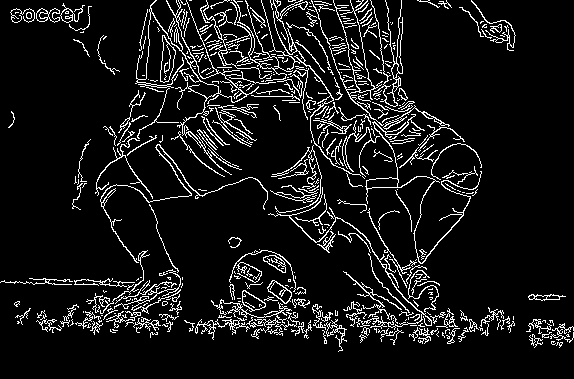


Tlow=100, Thigh=200



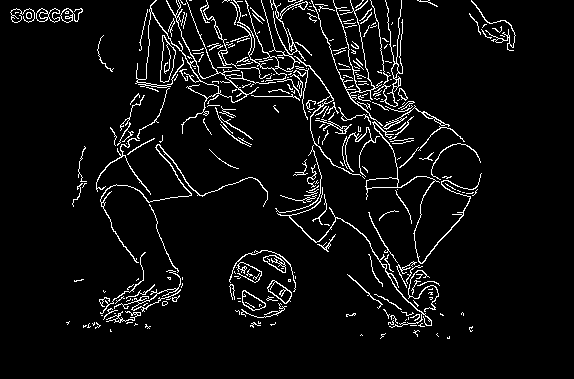

In [ ]:
##Canny Edge Detector

canny1=cv2.Canny(gray,50,150)	# Tlow=50, Thigh=150으로 설정
canny2=cv2.Canny(gray,100,200)	# Tlow=100, Thigh=200으로 설정

cv2_imshow(gray)
print("\nTlow=50, Thigh=150\n")
cv2_imshow(canny1)
print("\nTlow=100, Thigh=200\n")
cv2_imshow(canny2)

# **12. Morphology**

In [ ]:
#깃헙의 파일을 Colab 작업 디렉토리로 다운로드

!wget https://raw.githubusercontent.com/kjcheoi-class/CV/main/JohnHancocksSignature.png

--2025-04-07 03:22:51--  https://raw.githubusercontent.com/kjcheoi-class/CV/main/JohnHancocksSignature.png
Resolving raw.githubusercontent.com (raw.githubusercontent.com)... 185.199.109.133, 185.199.108.133, 185.199.110.133, ...
Connecting to raw.githubusercontent.com (raw.githubusercontent.com)|185.199.109.133|:443... connected.
HTTP request sent, awaiting response... 200 OK
Length: 59974 (59K) [image/png]
Saving to: ‘JohnHancocksSignature.png’

JohnHancocksSignatu 100%[===================>]  58.57K  --.-KB/s    in 0.01s   

2025-04-07 03:22:51 (4.16 MB/s) - ‘JohnHancocksSignature.png’ saved [59974/59974]



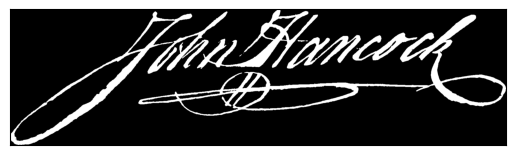

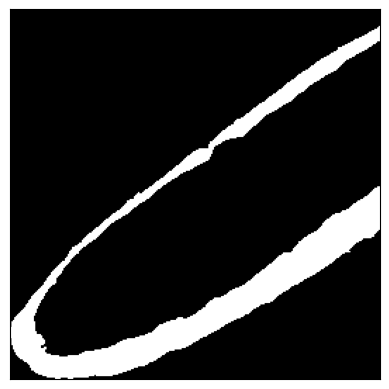


팽창(dilate) 연산 후


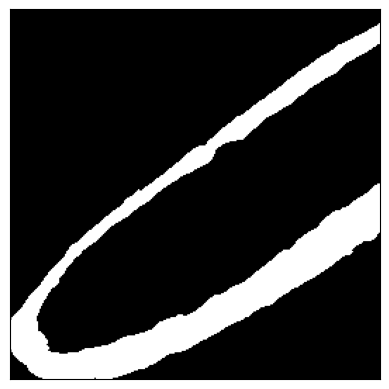


침식(edrode) 연산 후


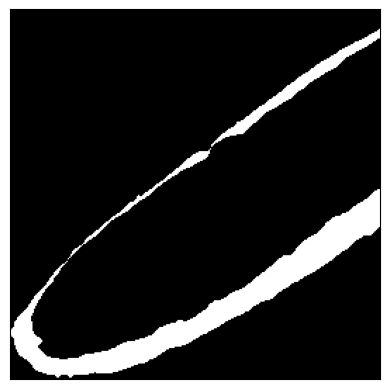


닫기(close) 연산 후


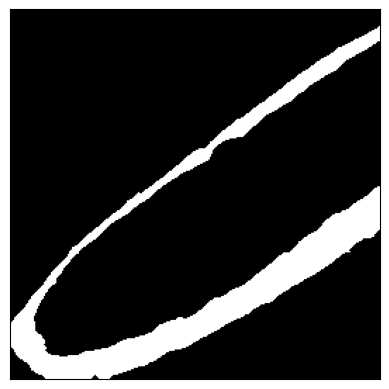

In [ ]:
img=cv2.imread('JohnHancocksSignature.png',cv2.IMREAD_UNCHANGED)

t,bin_img=cv2.threshold(img[:,:,3],0,255,cv2.THRESH_BINARY+cv2.THRESH_OTSU)
plt.imshow(bin_img,cmap='gray'), plt.xticks([]), plt.yticks([])
plt.show()

b=bin_img[bin_img.shape[0]//2:bin_img.shape[0],0:bin_img.shape[0]//2+1]
plt.imshow(b,cmap='gray'), plt.xticks([]), plt.yticks([])
plt.show()

se=np.uint8([[0,0,1,0,0],			# 구조 요소
            [0,1,1,1,0],
            [1,1,1,1,1],
            [0,1,1,1,0],
            [0,0,1,0,0]])

print("\n팽창(dilate) 연산 후")
b_dilation=cv2.dilate(b,se,iterations=1)	# 팽창
plt.imshow(b_dilation,cmap='gray'), plt.xticks([]), plt.yticks([])
plt.show()

print("\n침식(edrode) 연산 후")
b_erosion=cv2.erode(b,se,iterations=1)	# 침식
plt.imshow(b_erosion,cmap='gray'), plt.xticks([]), plt.yticks([])
plt.show()

print("\n닫기(close) 연산 후")
b_closing=cv2.erode(cv2.dilate(b,se,iterations=1),se,iterations=1)	# 닫기
plt.imshow(b_closing,cmap='gray'), plt.xticks([]), plt.yticks([])
plt.show()